In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import os
import glob
import numpy as np
import proplot as pplt
import matplotlib.pyplot as plt

import os
import pickle
import numpy as np
import pandas as pd
from tqdm import tqdm
import sklearn.metrics as skm
import uncertainty_toolbox as uct
from deephyper.gnn_uq.figure import sat
from deephyper.gnn_uq.analysis import conf_level, miscal_area
from deephyper.gnn_uq.data_utils import get_data, split_data

LABEL = ['Lipo', 'ESOL', 'FreeSolv', 'QM7', 'QM9']

COLOR = []

cycle = pplt.Cycle('ggplot')
cycle2 = pplt.Cycle('Dark2')
for c in cycle:
    COLOR.append(c['color'])
for c in cycle2:
    COLOR.append(c['color'])

In [3]:
import os
import ast
import pickle
import itertools
import pandas as pd
import numpy as np
import tensorflow as tf

from tensorflow.keras.optimizers.legacy import Adam
from deephyper.gnn_uq.load_data import load_data
from deephyper.gnn_uq.gnn_model import RegressionUQSpace, nll
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping


if os.path.exists("/scratch/gpfs/sj0161/autognnuq/"):
    ROOT_DIR = "/scratch/gpfs/sj0161/autognnuq/"
else:
    ROOT_DIR = "../autognnuq/"

if os.path.exists("/scratch/gpfs/sj0161/autognnuq/fig/"):
    PLOT_DIR = "/scratch/gpfs/sj0161/autognnuq/fig/"
else:
    PLOT_DIR = "../autognnuq/fig/"

if os.path.exists("/scratch/gpfs/sj0161/autognnuq/result/"):
    RESULT_DIR = "/scratch/gpfs/sj0161/autognnuq/result/"
else:
    RESULT_DIR = "../autognnuq/result/"

if os.path.exists("/scratch/gpfs/sj0161/autognnuq/data/"):
    DATA_DIR = "/scratch/gpfs/sj0161/autognnuq/data/"
else:
    DATA_DIR = "../autognnuq/data/"


2024-05-19 13:55:28.559831: I tensorflow/core/util/port.cc:110] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-05-19 13:55:29.708951: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F AVX512_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-05-19 13:55:31.842281: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


In [66]:
from deephyper.gnn_uq.figure import plot_tsne

# Best k = 20
# Best k = 20
# Best k = 3
# Best k = 3
# Best k = 22
# Best k = 22
# Best k = 29
# Best k = 29
# Best k = 4
# Best k = 4


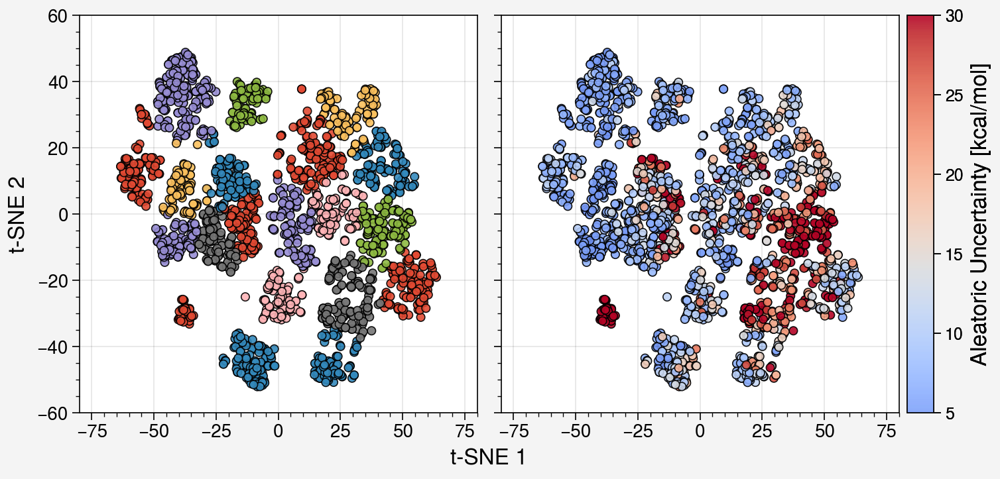

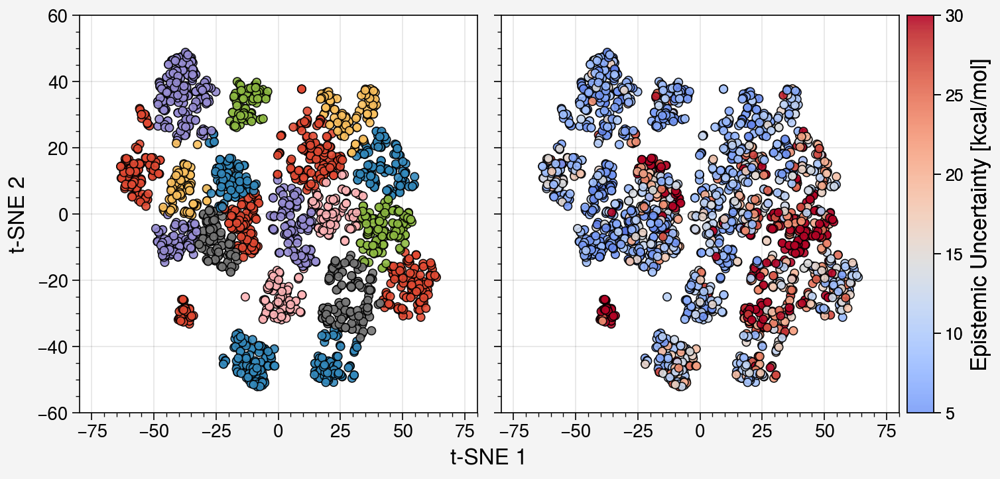

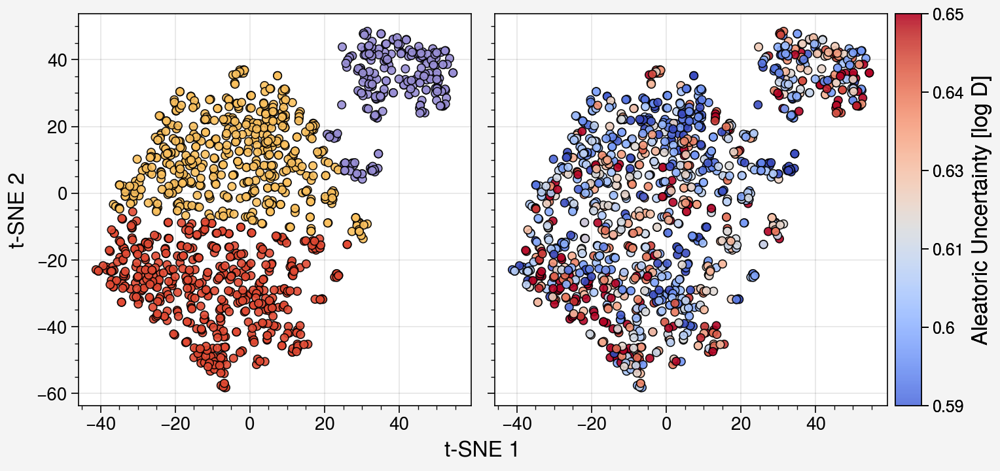

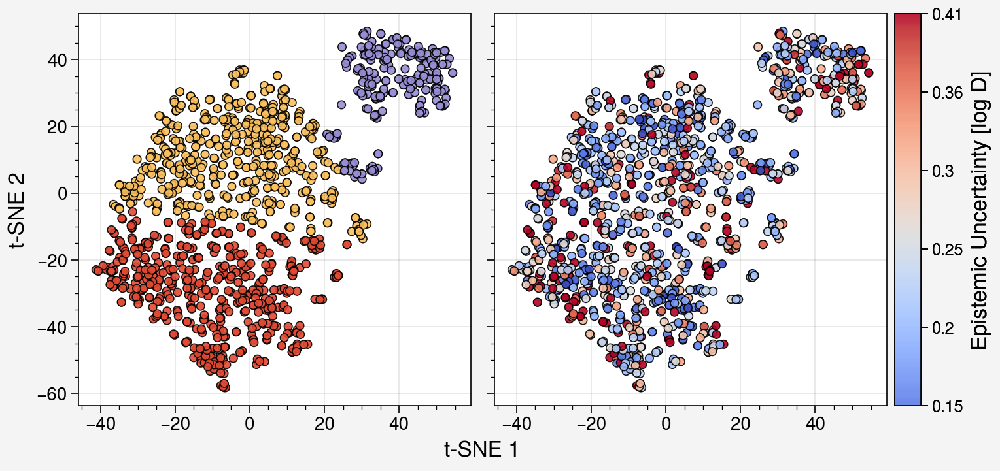

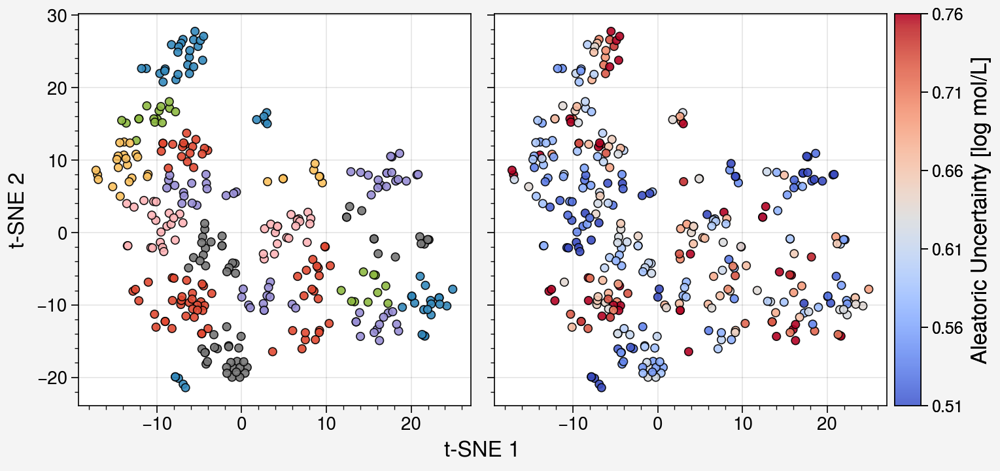

...

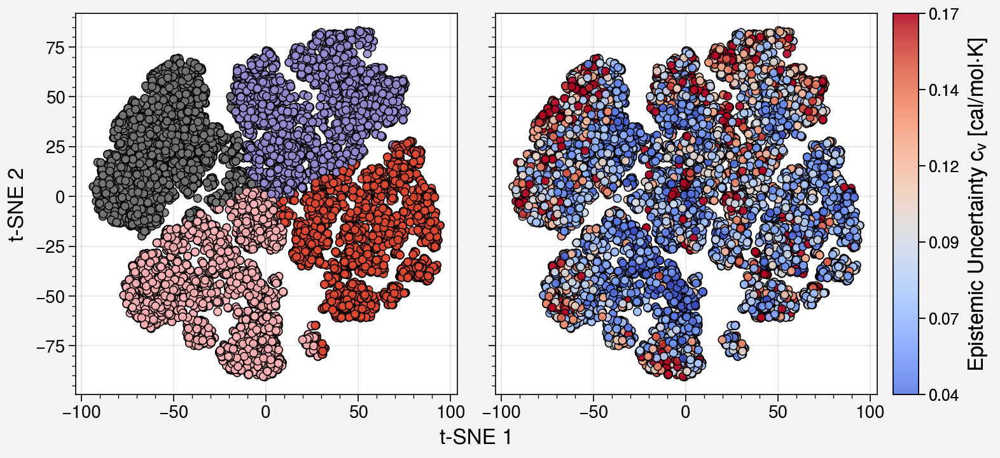

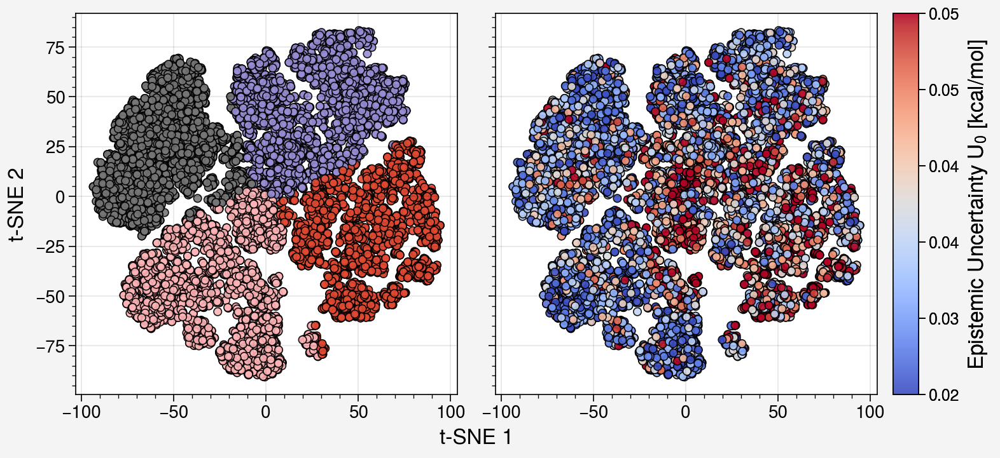

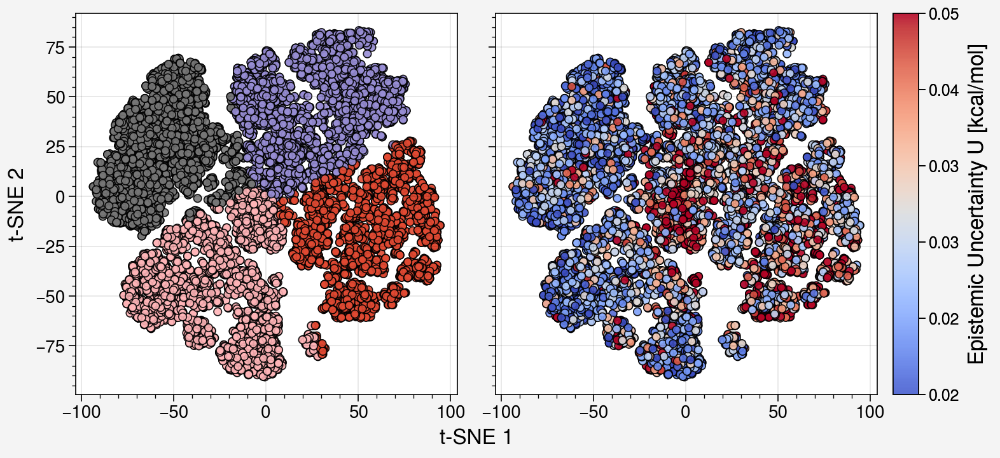

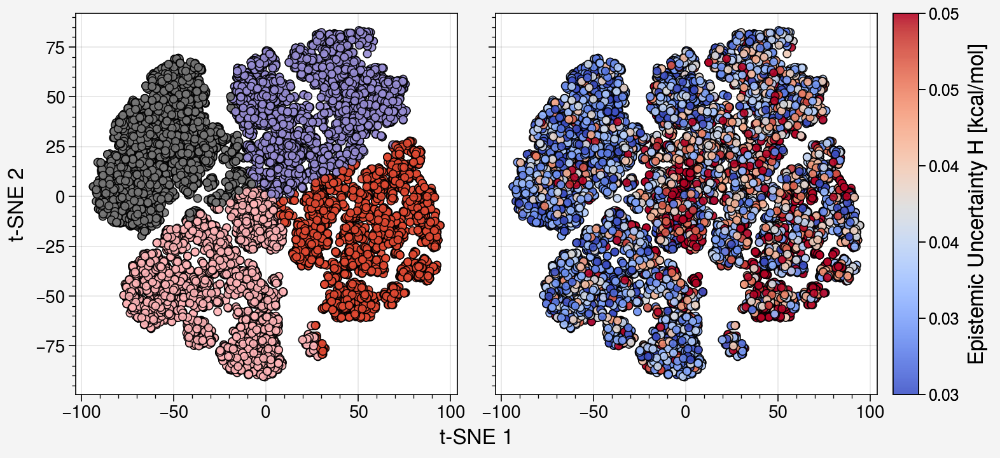

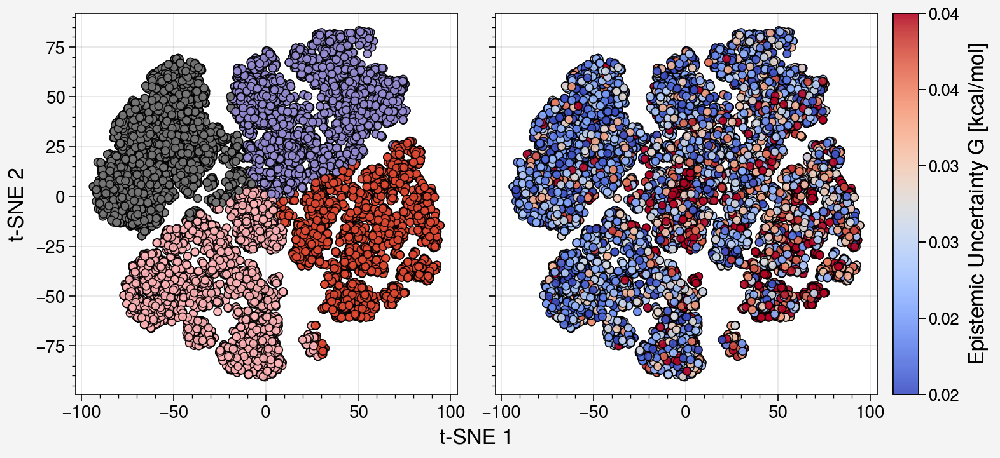

In [69]:
plot_tsne(ROOT_DIR, RESULT_DIR, DATA_DIR, COLOR, PLOT_DIR)

In [6]:
import os
import pickle
import numpy as np
import uncertainty_toolbox as uct
from deephyper.gnn_uq.figure import sat
from deephyper.gnn_uq.analysis import conf_level, miscal_area


def calculate_conf_calib(RESULT_DIR, model="normal"):
    LABELS = [
        "Lipo",
        "ESOL",
        "FreeSolv",
        "QM7" ,
        r"QM9 $\mu$",
        r"QM9 $\alpha$",
        r"QM9 $\epsilon_{\mathrm{HOMO}}$",
        r"QM9 $\epsilon_{\mathrm{LUMO}}$",
        r"QM9 $\Delta \epsilon$",
        r"QM9 $\langle R^2 \rangle$",
        r"QM9 ZPVE" ,
        r"QM9 $c_v$",
        r"QM9 $U_0$" ,
        r"QM9 $U$" ,
        r"QM9 $H$" ,
        r"QM9 $G$" ,
    ]
    
    if model == "mc":
        result_file = os.path.join(RESULT_DIR, "val_test_result_mc_dropout.pickle")
        qm9_result_file = os.path.join(RESULT_DIR, "val_test_result_qm9_mc_dropout.pickle")
        out_file = os.path.join(RESULT_DIR, "calib_mc_dropout.pickle")
    elif model == "simple":
        result_file = os.path.join(RESULT_DIR, "val_test_result_simple.pickle")
        qm9_result_file = os.path.join(RESULT_DIR, "val_test_result_qm9_simple.pickle")
        out_file = os.path.join(RESULT_DIR, "calib_simple.pickle")
    elif model == "random":
        result_file = os.path.join(RESULT_DIR, "val_test_result_random.pickle")
        qm9_result_file = os.path.join(RESULT_DIR, "val_test_result_qm9_random.pickle")
        out_file = os.path.join(RESULT_DIR, "calib_random.pickle")
    elif model == "normal":
        result_file = os.path.join(RESULT_DIR, "val_test_result.pickle")
        qm9_result_file = os.path.join(RESULT_DIR, "val_test_result_qm9.pickle")
        out_file = os.path.join(RESULT_DIR, "calib.pickle")
        
    
    if not os.path.exists(out_file):
        with open(out_file, "rb") as handle:
            output = pickle.load(handle)
    else:
        with open(result_file, "rb") as handle:
            result = pickle.load(handle)

        with open(qm9_result_file, "rb") as handle:
            result_qm9 = pickle.load(handle)

        output = {}

        for i in range(16):
            perc_tot = np.zeros((8, 100))
            perc_ale = np.zeros((8, 100))
            perc_epi = np.zeros((8, 100))
            MCA = np.zeros((8,))

            if i == 0:
                dataset = "lipo"
            elif i == 1:
                dataset = "delaney"
            elif i == 2:
                dataset = "freesolv"
            elif i == 3:
                dataset = "qm7"
            else:
                dataset = "qm9"

            for seed in range(8):
                if dataset == "qm9":
                    split = "811"

                    y_true, y_pred, y_epis, y_alea, v_true, v_pred, v_epis, v_alea = (
                        result_qm9[dataset, split, seed]
                    )
                    y_true = np.copy(y_true)[..., i - 4]
                    y_pred = np.copy(y_pred)[..., i - 4]
                    y_alea = np.copy(y_alea)[..., i - 4]
                    y_epis = np.copy(y_epis)[..., i - 4]

                    if i in [6, 7, 8, 10]:
                        y_true = y_true * 27.2114
                        y_pred = y_pred * 27.2114
                        y_alea = y_alea * (27.2114**2)
                        y_epis = y_epis * (27.2114**2)

                else:
                    split = "523"

                    y_true, y_pred, y_epis, y_alea, v_true, v_pred, v_epis, v_alea = result[
                        dataset, split, seed
                    ]

                cf1, perc_tot[seed] = conf_level(y_true, y_pred, (y_alea + y_epis) ** 0.5)
                cf2, perc_ale[seed] = conf_level(y_true, y_pred, (y_alea) ** 0.5)
                cf3, perc_epi[seed] = conf_level(y_true, y_pred, (y_epis) ** 0.5)
                MCA[seed] = miscal_area((y_alea + y_epis), y_pred, y_true)[0]

            diff = np.abs(perc_tot - cf1)
            ece = np.mean(diff, axis=1)

            mce = np.max(diff, axis=1)

            output[(LABELS[i], split, "before")] = [ece, mce, MCA]

        for i in range(16):
            perc_tot = np.zeros((8, 100))
            perc_ale = np.zeros((8, 100))
            perc_epi = np.zeros((8, 100))
            ratios = np.zeros((8,))
            MCA = np.zeros((8,))

            if i == 0:
                dataset = "lipo"
            elif i == 1:
                dataset = "delaney"
            elif i == 2:
                dataset = "freesolv"
            elif i == 3:
                dataset = "qm7"
            else:
                dataset = "qm9"

            for seed in range(8):
                if dataset == "qm9":
                    split = "811"

                    y_true, y_pred, y_epis, y_alea, v_true, v_pred, v_epis, v_alea = (
                        result_qm9[dataset, split, seed]
                    )
                    y_true = np.copy(y_true)[..., i - 4]
                    y_pred = np.copy(y_pred)[..., i - 4]
                    y_alea = np.copy(y_alea)[..., i - 4]
                    y_epis = np.copy(y_epis)[..., i - 4]
                    v_true = np.copy(v_true)[..., i - 4]
                    v_pred = np.copy(v_pred)[..., i - 4]
                    v_alea = np.copy(v_alea)[..., i - 4]
                    v_epis = np.copy(v_epis)[..., i - 4]

                    if i in [6, 7, 8, 10]:
                        y_true = y_true * 27.2114
                        y_pred = y_pred * 27.2114
                        y_alea = y_alea * (27.2114**2)
                        y_epis = y_epis * (27.2114**2)

                        v_true = v_true * 27.2114
                        v_pred = v_pred * 27.2114
                        v_alea = v_alea * (27.2114**2)
                        v_epis = v_epis * (27.2114**2)

                else:
                    split = "523"

                    y_true, y_pred, y_epis, y_alea, v_true, v_pred, v_epis, v_alea = result[
                        dataset, split, seed
                    ]

                a = uct.recalibration.optimize_recalibration_ratio(
                    y_mean=v_pred,
                    y_std=(v_alea + v_epis) ** 0.5,
                    y_true=v_true,
                    criterion="miscal",
                )
                

                cf1, perc_tot[seed] = conf_level(
                    y_true, y_pred, (a**2 * y_alea + a**2 * y_epis) ** 0.5
                )
                cf2, perc_ale[seed] = conf_level(y_true, y_pred, (a**2 * y_alea) ** 0.5)
                cf3, perc_epi[seed] = conf_level(y_true, y_pred, (a**2 * y_epis) ** 0.5)

                MCA[seed] = miscal_area((a**2 * y_alea + a**2 * y_epis), y_pred, y_true)[0]
                ratios[seed] = a

            diff = np.abs(perc_tot - cf1)
            ece = np.mean(diff, axis=1)

            mce = np.max(diff, axis=1)
            output[(LABELS[i], split, "after")] = [ece, mce, MCA, ratios]

        with open(out_file, "wb") as handle:
            pickle.dump(output, handle)
    return output

In [12]:
output = calculate_conf_calib(RESULT_DIR, model="random")
for key in list(output.keys())[:16]:
#     ece1 = output[key][0]
#     e1m = ece1.mean()
#     e1s = ece1.std()
    
#     mce1 = output[key][1]
#     c1m = mce1.mean()
#     c1s = mce1.std()
    
#     mca1 = output[key][2]
#     m1m = mca1.mean()
#     m1s = mca1.std()
    
    
    key2 = list(key)
    key2[-1] = "after"
    
#     ece2 = output[tuple(key2)][0]
#     e2m = ece2.mean()
#     e2s = ece2.std()
    
#     mce2 = output[tuple(key2)][1]
#     c2m = mce2.mean()
#     c2s = mce2.std()
    
#     mca2 = output[tuple(key2)][2]
#     m2m = mca2.mean()
#     m2s = mca2.std()
    
    ratio = output[tuple(key2)][3]
    r2m = ratio.mean()
    r2s = ratio.std()
    
    
#     str1 = r"\underline{\bf"
#     str2 = r"}"
#     stra = f"{key[0]:<30} & {e1m:0.3f} ({e1s:0.3f}) & {str1} {e2m:0.3f} ({e2s:0.3f}){str2}" 
#     strb = f" & {c1m:0.3f} ({c1s:0.3f}) & {str1} {c2m:0.3f} ({c2s:0.3f}){str2}"    
#     strc = f" & {m1m:0.3f} ({m1s:0.3f}) & {str1} {m2m:0.3f} ({m2s:0.3f}){str2}"
    
#     print(stra + strb + strc)
    print(f" {r2m:0.3f} ({r2s:0.3f})")

 0.827 (0.028)
 0.652 (0.063)
 0.522 (0.050)
 0.358 (0.052)
 0.799 (0.037)
 0.441 (0.044)
 0.634 (0.023)
 0.546 (0.041)
 0.581 (0.039)
 0.505 (0.038)
 0.429 (0.082)
 0.465 (0.061)
 0.257 (0.063)
 0.255 (0.067)
 0.255 (0.067)
 0.256 (0.064)


In [51]:
output = calculate_conf_calib(RESULT_DIR, model="random")
for key in list(output.keys())[:16]:
    ece1 = output[key][0]
    e1m = ece1.mean()
    e1s = ece1.std()
    
    mce1 = output[key][1]
    c1m = mce1.mean()
    c1s = mce1.std()
    
    mca1 = output[key][2]
    m1m = mca1.mean()
    m1s = mca1.std()
    
    
    key2 = list(key)
    key2[-1] = "after"
    
    ece2 = output[tuple(key2)][0]
    e2m = ece2.mean()
    e2s = ece2.std()
    
    mce2 = output[tuple(key2)][1]
    c2m = mce2.mean()
    c2s = mce2.std()
    
    mca2 = output[tuple(key2)][2]
    m2m = mca2.mean()
    m2s = mca2.std()
    
    
    str1 = r"\underline{\bf"
    str2 = r"}"
    stra = f"{key[0]:<30} & {e1m:0.3f} ({e1s:0.3f}) & {str1} {e2m:0.3f} ({e2s:0.3f}){str2}" 
    strb = f" & {c1m:0.3f} ({c1s:0.3f}) & {str1} {c2m:0.3f} ({c2s:0.3f}){str2}"    
    strc = f" & {m1m:0.3f} ({m1s:0.3f}) & {str1} {m2m:0.3f} ({m2s:0.3f}){str2}"
    
    print(stra + strb + strc)

Lipo                           & 0.063 (0.008) & \underline{\bf 0.009 (0.005)} & 0.106 (0.013) & \underline{\bf 0.023 (0.008)} & 0.063 (0.008) & \underline{\bf 0.009 (0.005)}
ESOL                           & 0.135 (0.018) & \underline{\bf 0.021 (0.013)} & 0.223 (0.032) & \underline{\bf 0.046 (0.019)} & 0.136 (0.018) & \underline{\bf 0.022 (0.013)}
FreeSolv                       & 0.185 (0.015) & \underline{\bf 0.035 (0.018)} & 0.317 (0.037) & \underline{\bf 0.079 (0.029)} & 0.187 (0.015) & \underline{\bf 0.035 (0.018)}
QM7                            & 0.241 (0.022) & \underline{\bf 0.020 (0.003)} & 0.442 (0.041) & \underline{\bf 0.081 (0.014)} & 0.243 (0.022) & \underline{\bf 0.020 (0.003)}
QM9 $\mu$                      & 0.072 (0.012) & \underline{\bf 0.006 (0.001)} & 0.114 (0.022) & \underline{\bf 0.016 (0.003)} & 0.073 (0.012) & \underline{\bf 0.006 (0.001)}
QM9 $\alpha$                   & 0.242 (0.021) & \underline{\bf 0.022 (0.003)} & 0.435 (0.040) & \underline{\bf 0.063 (0.011)

In [52]:
output = calculate_conf_calib(RESULT_DIR, model="mc")
for key in list(output.keys())[:16]:
    ece1 = output[key][0]
    e1m = ece1.mean()
    e1s = ece1.std()
    
    mce1 = output[key][1]
    c1m = mce1.mean()
    c1s = mce1.std()
    
    mca1 = output[key][2]
    m1m = mca1.mean()
    m1s = mca1.std()
    
    
    key2 = list(key)
    key2[-1] = "after"
    
    ece2 = output[tuple(key2)][0]
    e2m = ece2.mean()
    e2s = ece2.std()
    
    mce2 = output[tuple(key2)][1]
    c2m = mce2.mean()
    c2s = mce2.std()
    
    mca2 = output[tuple(key2)][2]
    m2m = mca2.mean()
    m2s = mca2.std()
    
    
    str1 = r"\underline{\bf"
    str2 = r"}"
    stra = f"{key[0]:<30} & {e1m:0.3f} ({e1s:0.3f}) & {str1} {e2m:0.3f} ({e2s:0.3f}){str2}" 
    strb = f" & {c1m:0.3f} ({c1s:0.3f}) & {str1} {c2m:0.3f} ({c2s:0.3f}){str2}"    
    strc = f" & {m1m:0.3f} ({m1s:0.3f}) & {str1} {m2m:0.3f} ({m2s:0.3f}){str2}"
    
    print(stra + strb + strc)

Lipo                           & 0.020 (0.010) & \underline{\bf 0.014 (0.008)} & 0.043 (0.016) & \underline{\bf 0.031 (0.011)} & 0.020 (0.010) & \underline{\bf 0.014 (0.008)}
ESOL                           & 0.017 (0.005) & \underline{\bf 0.019 (0.005)} & 0.043 (0.011) & \underline{\bf 0.048 (0.009)} & 0.017 (0.005) & \underline{\bf 0.020 (0.005)}
FreeSolv                       & 0.090 (0.049) & \underline{\bf 0.035 (0.009)} & 0.174 (0.080) & \underline{\bf 0.094 (0.026)} & 0.091 (0.049) & \underline{\bf 0.035 (0.009)}
QM7                            & 0.215 (0.030) & \underline{\bf 0.027 (0.007)} & 0.383 (0.059) & \underline{\bf 0.110 (0.022)} & 0.217 (0.030) & \underline{\bf 0.028 (0.007)}
QM9 $\mu$                      & 0.042 (0.009) & \underline{\bf 0.005 (0.002)} & 0.067 (0.014) & \underline{\bf 0.012 (0.006)} & 0.043 (0.009) & \underline{\bf 0.005 (0.002)}
QM9 $\alpha$                   & 0.200 (0.040) & \underline{\bf 0.004 (0.001)} & 0.322 (0.068) & \underline{\bf 0.010 (0.002)

In [53]:
output = calculate_conf_calib(RESULT_DIR, model="simple")
for key in list(output.keys())[:16]:
    ece1 = output[key][0]
    e1m = ece1.mean()
    e1s = ece1.std()
    
    mce1 = output[key][1]
    c1m = mce1.mean()
    c1s = mce1.std()
    
    mca1 = output[key][2]
    m1m = mca1.mean()
    m1s = mca1.std()
    
    
    key2 = list(key)
    key2[-1] = "after"
    
    ece2 = output[tuple(key2)][0]
    e2m = ece2.mean()
    e2s = ece2.std()
    
    mce2 = output[tuple(key2)][1]
    c2m = mce2.mean()
    c2s = mce2.std()
    
    mca2 = output[tuple(key2)][2]
    m2m = mca2.mean()
    m2s = mca2.std()
    
    
    str1 = r"\underline{\bf"
    str2 = r"}"
    stra = f"{key[0]:<30} & {e1m:0.3f} ({e1s:0.3f}) & {str1} {e2m:0.3f} ({e2s:0.3f}){str2}" 
    strb = f" & {c1m:0.3f} ({c1s:0.3f}) & {str1} {c2m:0.3f} ({c2s:0.3f}){str2}"    
    strc = f" & {m1m:0.3f} ({m1s:0.3f}) & {str1} {m2m:0.3f} ({m2s:0.3f}){str2}"
    
    print(stra + strb + strc)

Lipo                           & 0.025 (0.011) & \underline{\bf 0.012 (0.006)} & 0.048 (0.017) & \underline{\bf 0.026 (0.011)} & 0.025 (0.011) & \underline{\bf 0.012 (0.006)}
ESOL                           & 0.040 (0.025) & \underline{\bf 0.026 (0.013)} & 0.082 (0.034) & \underline{\bf 0.057 (0.019)} & 0.041 (0.025) & \underline{\bf 0.026 (0.013)}
FreeSolv                       & 0.084 (0.051) & \underline{\bf 0.037 (0.015)} & 0.159 (0.071) & \underline{\bf 0.079 (0.030)} & 0.085 (0.051) & \underline{\bf 0.037 (0.015)}
QM7                            & 0.271 (0.013) & \underline{\bf 0.031 (0.006)} & 0.488 (0.022) & \underline{\bf 0.129 (0.011)} & 0.274 (0.013) & \underline{\bf 0.032 (0.006)}
QM9 $\mu$                      & 0.032 (0.019) & \underline{\bf 0.007 (0.003)} & 0.058 (0.027) & \underline{\bf 0.018 (0.010)} & 0.032 (0.020) & \underline{\bf 0.007 (0.004)}
QM9 $\alpha$                   & 0.094 (0.015) & \underline{\bf 0.006 (0.002)} & 0.147 (0.022) & \underline{\bf 0.018 (0.005)

In [60]:
from deephyper.gnn_uq.figure import plot_pc9_parity

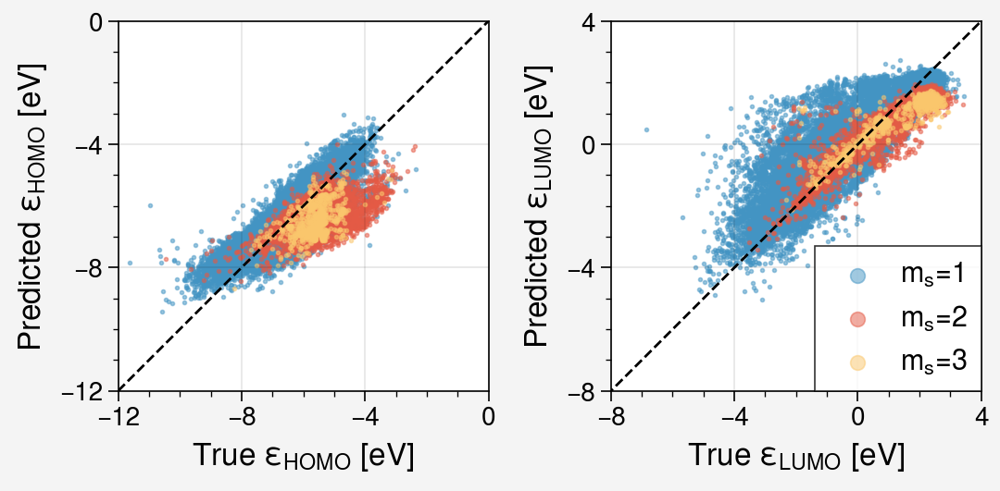

In [137]:
plot_pc9_parity(ROOT_DIR, RESULT_DIR, DATA_DIR, LABEL, COLOR, PLOT_DIR, format="png")

In [294]:
from deephyper.gnn_uq.figure.pc9 import load_data_

y_true, y_pred, y_epis, y_alea = load_data_(ROOT_DIR, RESULT_DIR)

In [295]:
# MAE
a=skm.mean_absolute_error(y_true[:, 1] * 0.0433634, y_pred[:, 0])
b=skm.mean_absolute_error(y_true[:, 2] * 0.0433634, y_pred[:, 1])

print([a, b])

[0.3399653173715217, 0.3687519855867181]


In [19]:
# MAE
a=skm.r2_score(y_true[:, 1]* 0.0433634, y_pred[:, 0])
b=skm.r2_score(y_true[:, 2]* 0.0433634, y_pred[:, 1])

print([a, b])

[0.6560671931872519, 0.8366225502375372]


In [20]:
# MAE
a=skm.mean_absolute_error(y_true[idx1, 1] * 0.0433634, y_pred[idx1, 0])
b=skm.mean_absolute_error(y_true[idx1, 2] * 0.0433634, y_pred[idx1, 1])

print([a, b])

[0.29937631121428726, 0.3580739243781279]


In [21]:
# MAE
a=skm.mean_absolute_error(y_true[idx2, 1] * 0.0433634, y_pred[idx2, 0])
b=skm.mean_absolute_error(y_true[idx2, 2] * 0.0433634, y_pred[idx2, 1])

print([a, b])

[0.8877534862143667, 0.49328332014591825]


In [22]:
# MAE
a=skm.mean_absolute_error(y_true[idx3, 1] * 0.0433634, y_pred[idx3, 0])
b=skm.mean_absolute_error(y_true[idx3, 2] * 0.0433634, y_pred[idx3, 1])

print([a, b])

[0.9155196537091655, 0.6192401990184756]


In [26]:
print(f"{np.log(y_epis[idx1, 0]).mean():0.3f} ({np.log(y_epis[idx1, 0]).std():0.3f})")
print(f"{np.log(y_epis[idx2, 0]).mean():0.3f} ({np.log(y_epis[idx2, 0]).std():0.3f})")
print(f"{np.log(y_epis[idx3, 0]).mean():0.3f} ({np.log(y_epis[idx3, 0]).std():0.3f})")

-3.223 (1.045)
-3.015 (0.627)
-3.254 (0.570)


In [325]:
idx1 = np.where(y_true[:, -1] == 1)[0]
idx2 = np.where(y_true[:, -1] != 1)[0]
# idx3 = np.where(y_true[:, -1] >= 3)[0]



print(f"{(y_epis[idx1, 0]**0.5).mean():0.3f} ({(y_epis[idx1, 0]**0.5).std():0.3f})")
print(f"{(y_epis[idx2, 0]**0.5).mean():0.3f} ({(y_epis[idx2, 0]**0.5).std():0.3f})")
# print(f"{(y_epis[idx3, 0]**0.5).mean():0.3f} ({(y_epis[idx3, 0]**0.5).std():0.3f})")


0.227 (0.117)
0.229 (0.082)


In [326]:
idx1 = np.where(y_true[:, -1] == 1)[0]
idx2 = np.where(y_true[:, -1] != 1)[0]
# idx3 = np.where(y_true[:, -1] >= 3)[0]



print(f"{(y_epis[idx1, 1]**0.5).mean():0.3f} ({(y_epis[idx1, 1]**0.5).std():0.3f})")
print(f"{(y_epis[idx2, 1]**0.5).mean():0.3f} ({(y_epis[idx2, 1]**0.5).std():0.3f})")
# print(f"{(y_epis[idx3, 0]**0.5).mean():0.3f} ({(y_epis[idx3, 0]**0.5).std():0.3f})")


0.279 (0.153)
0.308 (0.102)


In [27]:
print(f"{np.log(y_epis[idx1, 1]).mean():0.3f} ({np.log(y_epis[idx1, 1]).std():0.3f})")
print(f"{np.log(y_epis[idx2, 1]).mean():0.3f} ({np.log(y_epis[idx2, 1]).std():0.3f})")
print(f"{np.log(y_epis[idx3, 1]).mean():0.3f} ({np.log(y_epis[idx3, 1]).std():0.3f})")

-2.864 (1.155)
-2.456 (0.593)
-2.366 (0.474)


In [125]:
print(f"{y_alea[idx1, 1].mean():0.3f} ({y_alea[idx1, 1].std():0.3f})")
print(f"{y_alea[idx2, 1].mean():0.3f} ({y_alea[idx2, 1].std():0.3f})")
print(f"{y_alea[idx3, 1].mean():0.3f} ({y_alea[idx3, 1].std():0.3f})")

0.039 (0.073)
0.039 (0.045)
0.038 (0.056)


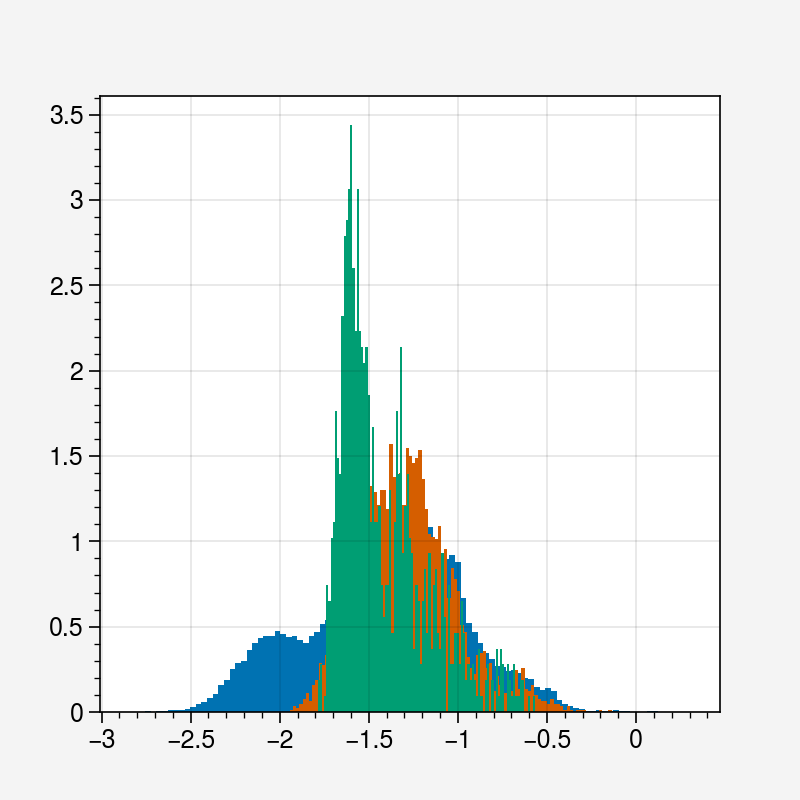

In [29]:
plt.hist(np.log10(y_epis[idx1, 0]), bins=100, density=True);
plt.hist(np.log10(y_epis[idx2, 0]), bins=100, density=True);
plt.hist(np.log10(y_epis[idx3, 0]), bins=100, density=True);

In [300]:
from deephyper.gnn_uq.analysis import NLL, cNLL, miscal_area, conf_level
from scipy.stats import spearmanr

NLL(y_epis[:, 0] + y_alea[:, 0], y_pred[:, 0], y_true[:, 1] * 0.0433634)

1.09620297794893

In [301]:
NLL(y_epis[:, 1] + y_alea[:, 1], y_pred[:, 1], y_true[:, 2] * 0.0433634)

1.037340812692152

In [297]:
miscal_area(y_epis[:, 0] + y_alea[:, 0], y_pred[:, 0], y_true[:, 1] * 0.0433634)[0]

0.0995806682699688

In [298]:
miscal_area(y_epis[:, 1] + y_alea[:, 1], y_pred[:, 1], y_true[:, 2] * 0.0433634)[0]

0.06093434989510311

In [302]:
spearmanr(y_epis[:, 0] + y_alea[:, 0], np.abs(y_true[:, 1] * 0.0433634 - y_pred[:, 0])).correlation

0.3251058528810663

In [303]:
spearmanr(y_epis[:, 1] + y_alea[:, 1], np.abs(y_true[:, 2] * 0.0433634 - y_pred[:, 1])).correlation

0.37901923751183214

In [91]:
from deephyper.gnn_uq.figure import plot_pc9_unc_err

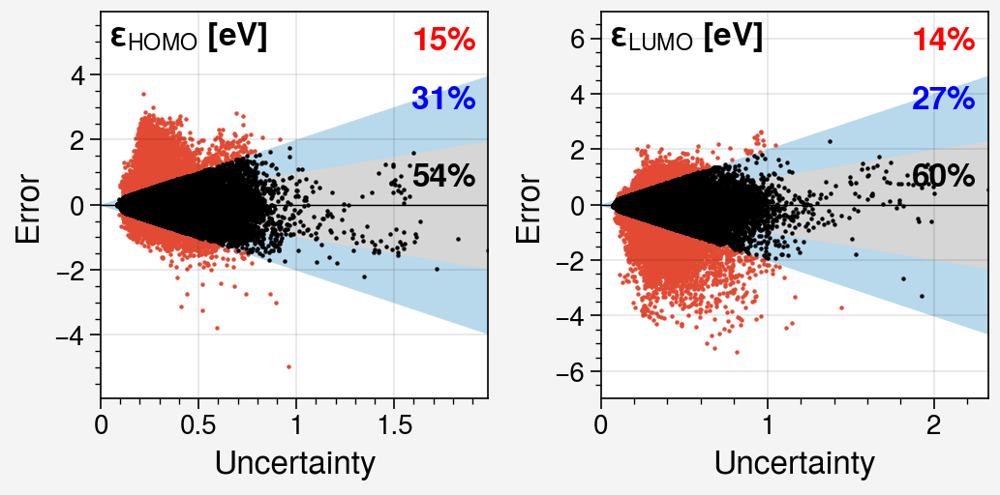

In [93]:
plot_pc9_unc_err(ROOT_DIR, RESULT_DIR, DATA_DIR, LABEL, COLOR, PLOT_DIR, format="pdf")

In [86]:
from deephyper.gnn_uq.figure import plot_pc9_conf

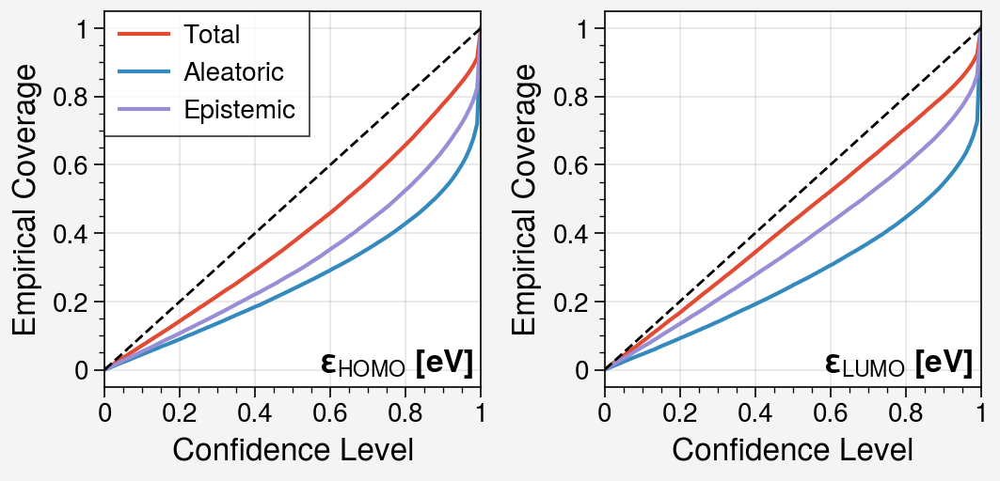

In [89]:
plot_pc9_conf(ROOT_DIR, RESULT_DIR, DATA_DIR, LABEL, COLOR, PLOT_DIR, format="pdf")

In [71]:
from deephyper.gnn_uq.figure import plot_pc9_decomp

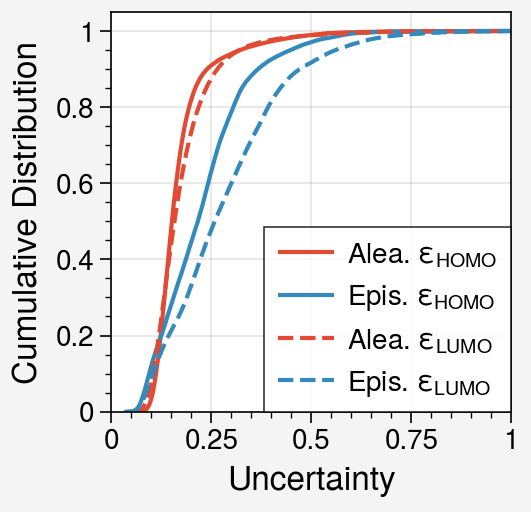

In [132]:
plot_pc9_decomp(ROOT_DIR, RESULT_DIR, DATA_DIR, LABEL, COLOR, PLOT_DIR, format="pdf")

In [94]:
y_true.shape

(78172, 4)

In [95]:
y_epis

array([[0.02590111, 0.03282477],
       [0.32354237, 0.39100886],
       [0.01589823, 0.04726897],
       ...,
       [0.26422176, 0.47949996],
       [0.06031113, 0.0923646 ],
       [0.00727643, 0.0061034 ]])

In [4]:
from deephyper.gnn_uq.figure.pc9 import load_data_, load_pca_data_

y_true, y_pred, y_epis, y_alea = load_data_(ROOT_DIR, RESULT_DIR)

pca_pc9, pca_qm9, maccs_pc9, maccs_qm9 = load_pca_data_(DATA_DIR, RESULT_DIR)
# pca_pc9 = pca_pc9[:, 0]
# pca_qm9 = pca_qm9[:, 0]

from scipy.spatial.distance import mahalanobis

from rdkit import DataStructs
from rdkit.DataStructs.cDataStructs import TanimotoSimilarity

In [6]:
from scipy.spatial.distance import cdist, cosine

# Example data
# pca_pc9 = np.random.randn(100000, 167)  # Replace with your actual data
# pca_qm9 = np.random.randn(100000, 167)  # Replace with your actual data

chunk_size = 1000  # Define a chunk size that fits into memory

max_similarities = []

for start in tqdm(range(0, len(pca_pc9), chunk_size)):
    end = min(start + chunk_size, len(pca_pc9))
    chunk_pc9 = pca_pc9[start:end]
    
    cosine_similarities = 1 - cdist(chunk_pc9, pca_qm9, metric='cosine')
    max_similarities_chunk = np.max(cosine_similarities, axis=1)
    
    max_similarities.extend(max_similarities_chunk)

max_similarities = np.array(max_similarities)

print("Maximum similarities for each vector in pca_pc9:", max_similarities)

100%|██████████| 79/79 [18:50<00:00, 14.31s/it]

Maximum similarities for each vector in pca_pc9: [0.69612785 0.65965717 0.68265885 ... 0.64858577 0.52144893 0.84368544]


In [8]:
# with open("/scratch/gpfs/sj0161/autognnuq/result/similarity.pickle", "wb") as handle:
#     pickle.dump(max_similarities, handle)

In [118]:
with open("/scratch/gpfs/sj0161/autognnuq/result/similarity.pickle", "rb") as handle:
    max_similarities = pickle.load(handle)

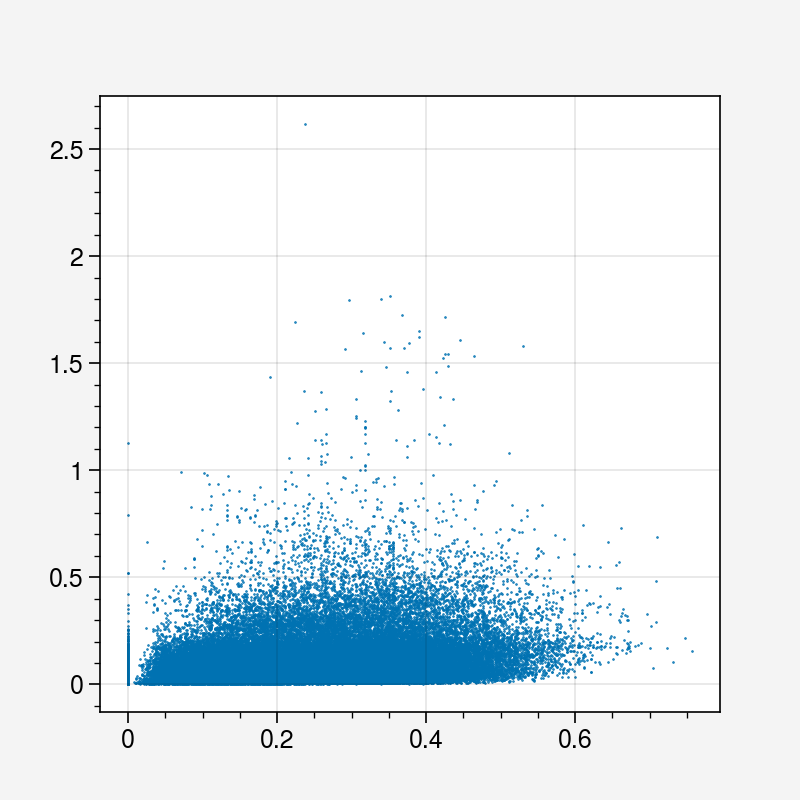

In [119]:
plt.scatter(1-max_similarities, y_epis[:, 1], s=0.1)

In [120]:
pearsonr(1-max_similarities, y_epis[:, 1]).correlationlation

0.23206050695226313

In [ ]:
from scipy.spatial.distance import cdist
cosine_similarities = 1 - cdist(pca_pc9, pca_qm9, metric='cosine')

In [ ]:
max_similarities = np.max(cosine_similarities, axis=1)

In [22]:
mean = np.mean(pca_qm9[:, :50], axis=0)
cov_matrix = np.cov(pca_qm9[:, :50], rowvar=False)
std_dev = np.std(pca_qm9[:, :50], axis=0)

In [23]:
mahalanobis_distance = []
inv_cov_matrix = np.linalg.inv(cov_matrix)

for i in tqdm(range(len(pca_pc9))):
    mahalanobis_distance.append(mahalanobis(pca_pc9[i, :50], mean, inv_cov_matrix))
#     mahalanobis_distance.append(np.linalg.norm((pca_pc9[i, :100] - mean) / std_dev))

mahalanobis_distance = np.array(mahalanobis_distance)
print(f"Mahalanobis Distance: {mahalanobis_distance.mean()}")

100%|██████████| 78172/78172 [00:00<00:00, 183835.65it/s]

Mahalanobis Distance: 9.540666809280458


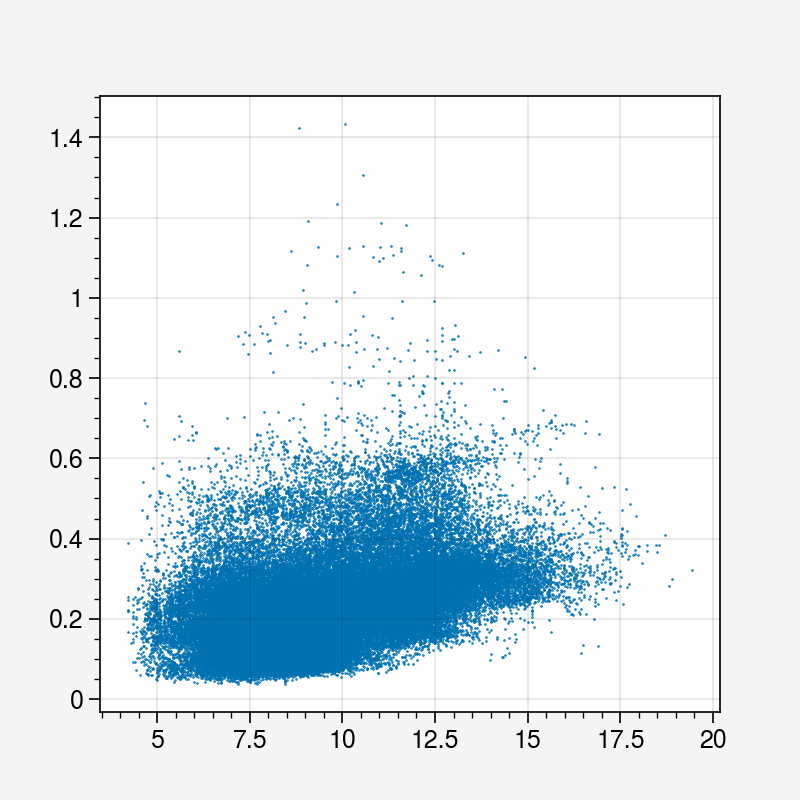

In [24]:
plt.scatter(mahalanobis_distance, y_epis[:, 0] ** 0.5, s=.1)

In [116]:
from scipy.stats import spearmanr, norm, pearsonr

In [117]:
pearsonr(mahalanobis_distance, y_epis[:, 1] ** 0.5).correlation

NameError: name 'mahalanobis_distance' is not defined

In [26]:
np.polyfit(mahalanobis_distance, y_epis[:, 0] ** 0.5, deg=1)

array([0.02215178, 0.01617468])

In [244]:
# fig, ax = pplt.subplots(refheight=2, refwidth=2, ncols=1, nrows=1, share=False)

vmin = min([min(pca_pc9[:, 0]), min(pca_qm9[:, 0])])
vmax = max([max(pca_pc9[:, 0]), max(pca_qm9[:, 0])])


(den1, bins, _) = ax.hist(pca_pc9[:, 0], density=False, bins=np.linspace(vmin, vmax, 25), alpha=0.5, c=COLOR[0])
(den2, bins, _) = ax.hist(pca_qm9[:, 0], density=False, bins=np.linspace(vmin, vmax, 25), alpha=0.5, c=COLOR[1]);

In [239]:
epi_bin = []
den_diff = []
for i in range(len(bins)-1):
    
    idx = np.where((pca_pc9[:, 0] >= bins[i]) & (pca_pc9[:, 0] <= bins[i+1]))[0]
    
    if len(idx) >= 1:
        y_epis_mean = (y_epis[idx, 0]).mean()
        epi_bin.append(y_epis_mean)
        
#         M = 0.5 * (den1[i] + den2[i])
        
#         js_divergence = 0.5 * (den1[i] * np.log((den1[i]) / (M)) + den2[i] * np.log((den2[i]) / (M)))
        rel_diff = np.abs(den1[i]) / (den2[i]) #+ np.abs(den1[i] - den2[i]) / (den1[i])
        den_diff.append(rel_diff)
    
epi_bin = np.array(epi_bin)
den_diff = np.array(den_diff)

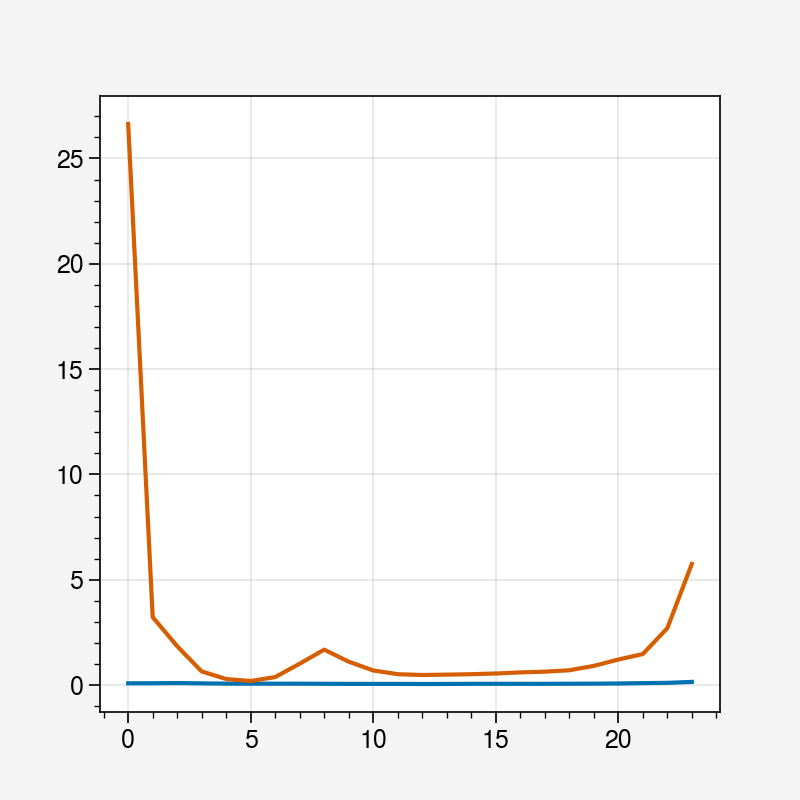

In [240]:
plt.plot(epi_bin)
plt.plot(den_diff)

In [284]:
from deephyper.gnn_uq.figure import plot_pc9_similarity, plot_pc9_decomp

0.5608695652173912
0.46173913043478254


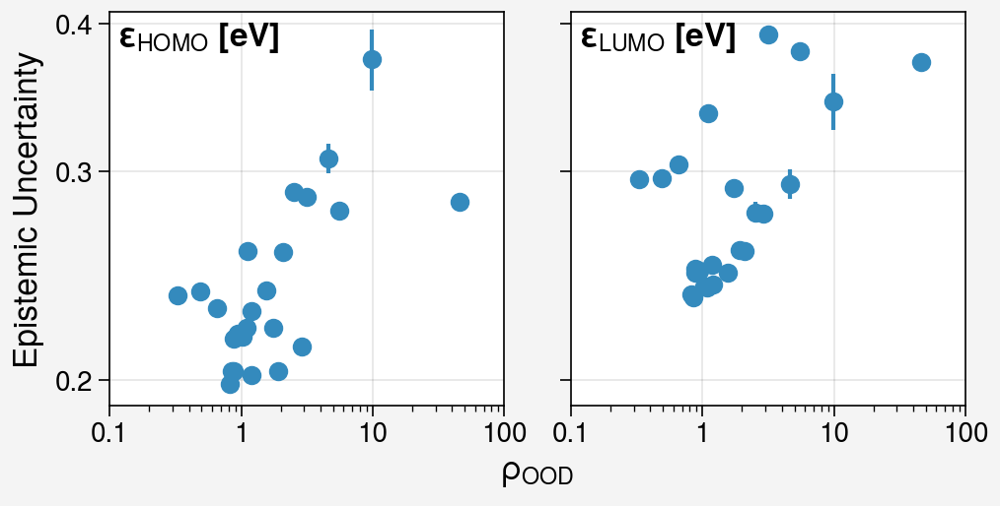

In [292]:
plot_pc9_similarity(
    ROOT_DIR, RESULT_DIR, DATA_DIR, LABEL, COLOR, PLOT_DIR, format="pdf"
)

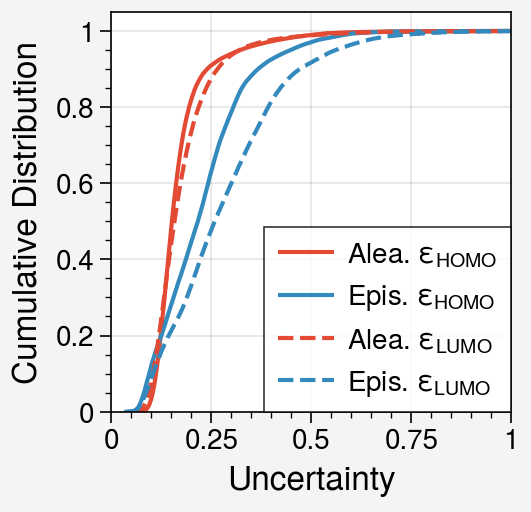

In [289]:
plot_pc9_decomp(ROOT_DIR, RESULT_DIR, DATA_DIR, LABEL, COLOR, PLOT_DIR, format="pdf")

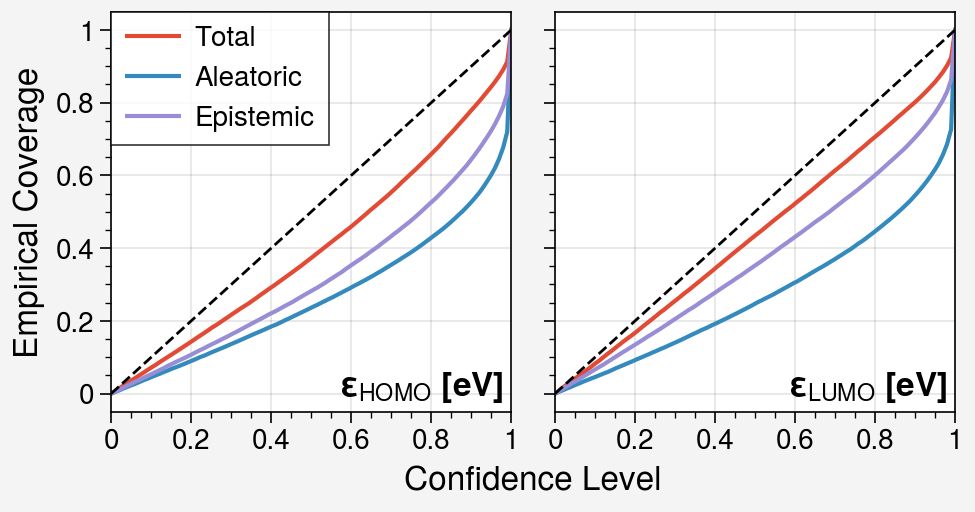

In [291]:
plot_pc9_conf(ROOT_DIR, RESULT_DIR, DATA_DIR, LABEL, COLOR, PLOT_DIR, format="pdf")

In [242]:
spearmanr(den_diff, epi_bin).correlation

0.6017391304347826

In [243]:
pearsonr(den_diff, epi_bin).correlation

0.30781859795078237

In [ ]:
epi_bin = []
den_diff = []
data_density = []
for i in range(len(bins)-1):
    idx = np.where((pca_pc9[:, 0] >= bins[i]) & (pca_pc9[:, 0] <= bins[i+1]))[0]
    
    if len(idx) >= 1:
        y_epis_mean = (y_epis[idx, 0]).mean()
        epi_bin.append(y_epis_mean)
        den_diff.append(np.abs(den2[i] - den1[i]))
        data_density.append(len(idx))


epi_bin = np.array(epi_bin)
den_diff = np.array(den_diff)
data_density = np.array(data_density)

# Print data density and epistemic uncertainty for debugging
print("Data density in bins:", data_density)
print("Epistemic uncertainty in bins:", epi_bin)
print("Density differences in bins:", den_diff)

<a list of 1 Line2D objects>

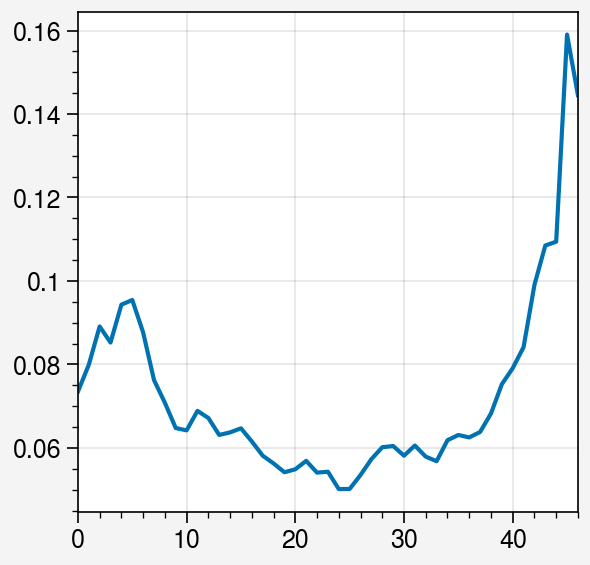

In [57]:
fig, ax = pplt.subplots(ncols=1, nrows=1, share=False)
ax.plot(epi_bin)